# Part 2 Data Cleaning and Exploratory Data Analysis

This workbook is 2 out of 3 parts of an Natural Language Processing (NLP) classification model. The focus of this part is on cleaning the data, preprocessing it before feeding it into models in part 3, as well as exploratory data analysis.

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

%matplotlib inline

In [2]:
# Set option to display max columns always
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
# Create dataframes by reading csv
nostupid = pd.read_csv('../datasets/nostupid.csv')
legal = pd.read_csv('../datasets/legaladvice.csv')

In [4]:
nostupid.describe()

,Unnamed: 0,num_comments,score,upvote_ratio,created_utc
count,12014.000000,12014.000000,12014.000000,12014.000000,1.201400e+04
mean,49.646829,0.049942,1.002164,0.998744,1.647160e+09
std,28.730973,0.224607,0.091212,0.023984,3.437939e+05
min,0.000000,0.000000,0.000000,0.330000,1.646574e+09
25%,24.000000,0.000000,1.000000,1.000000,1.646860e+09
50%,50.000000,0.000000,1.000000,1.000000,1.647154e+09
75%,75.000000,0.000000,1.000000,1.000000,1.647459e+09
max,99.000000,3.000000,6.000000,1.000000,1.647752e+09


In [5]:
legal.describe()

,Unnamed: 0,num_comments,score,upvote_ratio,created_utc
count,12049.000000,12049.000000,12049.000000,12049.000000,1.204900e+04
mean,49.596481,0.004067,1.000747,0.999660,1.646749e+09
std,28.844531,0.066201,0.043686,0.012068,5.848076e+05
min,0.000000,0.000000,0.000000,0.500000,1.645718e+09
25%,25.000000,0.000000,1.000000,1.000000,1.646250e+09
50%,50.000000,0.000000,1.000000,1.000000,1.646765e+09
75%,75.000000,0.000000,1.000000,1.000000,1.647280e+09
max,99.000000,2.000000,2.000000,1.000000,1.647752e+09


#### Redundant `Unnamed:0` indexing column:
Noted that there is an `Unnamed: 0` column which I will be dropping to make cleaner.

#### Higher `num_comment` when compared:
At the outset, we can see that there is a higher mean for `num_comments` for `r/NoStupidQuestions` compared to `r/legalqueries`. This paints the picture that participants within the subreddit are more vocal in discussing the topics submitted. Having a mean number of comment to be less than 1 also suggests that most submissions do not end up getting a reply from the community reading the subreddit, signifying either a poorly written post that no reader understands, or a boring posts that no one bothers replying to.

#### Higher max `score` when compared:
`r/NoStupidQuestions` has a max upvote `score` of 6 compared to `r/legalqueries` max upvote score of 2. This suggest thats that there might be more interesting and hilarious or helpful questions that are posted than the other subreddit. It may also suggest that there simply is more participants leading to more likes being given out to posters. Mean scores for both subreddits are both very close to 1, suggesting that most posts do not get upvoted since 1 is the baseline that is given when a submission is created.

#### Both subreddits having `upvote_ratio` less than count:
Having a `upvote_ratio` of less than 1 means that there are several posts that other readers left downvotes on the submissions. This shows that both subreddits have an inclination towards being negative and not being gracious in the giving of upvotes. This is in addition to most submissions getting no upvotes which was earlier observed.

In [6]:
nostupid.drop(columns = "Unnamed: 0", inplace = True)
legal.drop(columns = "Unnamed: 0", inplace = True)

In [7]:
nostupid.head()

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc
0,throawaybitch,True,False,0,/r/NoStupidQuestions/comments/tidkny/is_differ...,1,Suppose we kidnap 100 infant babies all of dif...,NoStupidQuestions,Is different human behaviours occur because of...,1.0,1647752132
1,AltairTheNightjar,True,False,0,/r/NoStupidQuestions/comments/tidhzu/how_did_k...,1,"They get richer after Japan, AFIK Japan get ri...",NoStupidQuestions,How did Korea get rich ?,1.0,1647751846
2,Fadecation,True,False,0,/r/NoStupidQuestions/comments/tidhzs/if_i_went...,1,Just a random questions that popped into my mi...,NoStupidQuestions,If I went to the past and force my dad to ejac...,1.0,1647751846
3,sadsackoffun1,True,False,0,/r/NoStupidQuestions/comments/tidgop/how_do_ri...,1,Is there like a giant hole somewhere it comes ...,NoStupidQuestions,How do rivers start?,1.0,1647751706
4,WeirdUniversity136,True,False,0,/r/NoStupidQuestions/comments/tidgc3/why_is_it...,1,I have worked plenty of service jobs and in my...,NoStupidQuestions,Why is it almost always old/middle aged people...,1.0,1647751669


### Description of columns

The columns with the dataframe for both subreddits contain the following:

1) `author` - the username of the author who created the Reddit post

2) `is_self` - a text post that does not link to anywhere outside of Reddit

3) `is_video` - whether a post is a video or not

4) `num_comment` - refers to the number of comments that are made on the Reddit thread

5) `permalink` - the URL link to the original post. Would come in handy for checking any erroneous or duplicate posting if any

6) `score` - the number of likes that other users have given to the created Reddit post

7) `selftext` - the main text body, or the content of the Reddit thread

8) `subreddit` - the subreddit that the submission was being posted on

9) `title` - the title/ header that the thread was created with

10) `upvote_ratio` - the upvote to comment ratio for the Reddit thread in question

11) `created_utc` - the timestamp that the thread was created in UTC timing

### Other initial analysis

In [8]:
# Change True to 1 and False to 0 for is_self and is_video
nostupid['is_self'] = nostupid['is_self'].apply(lambda x: 1 if x == True else 0)
nostupid['is_video'] = nostupid['is_video'].apply(lambda x: 1 if x == True else 0)
legal['is_self'] = legal['is_self'].apply(lambda x: 1 if x == True else 0)
legal['is_video'] = legal['is_video'].apply(lambda x: 1 if x == True else 0)

In [9]:
# Check for 1 for is_self being True, and 0 for being False
nostupid.groupby('is_self').sum()

,is_video,num_comments,score,upvote_ratio,created_utc
is_self,,,,,
1,0,600,12040,11998.91,19788975123778


In [10]:
legal.groupby('is_self').sum()

,is_video,num_comments,score,upvote_ratio,created_utc
is_self,,,,,
1,0,49,12058,12044.9,19841677475728


All submissions within both subreddit are posts that do not link outside of Reddit. As such, the information is contained within the `title` and `selftext` alone.

In [11]:
nostupid.groupby('is_video').sum()

,is_self,num_comments,score,upvote_ratio,created_utc
is_video,,,,,
0,12014,600,12040,11998.91,19788975123778


In [12]:
legal.groupby('is_video').sum()

,is_self,num_comments,score,upvote_ratio,created_utc
is_video,,,,,
0,12049,49,12058,12044.9,19841677475728


It is interesting to see that these 2 subreddit similarly has no video postings, which is quite rare on Reddit. This might be due to the nature of `/rNoStupidQuestions` being a questions oriented subreddit leading to an inclination for self created questions that are not linked to external materials.

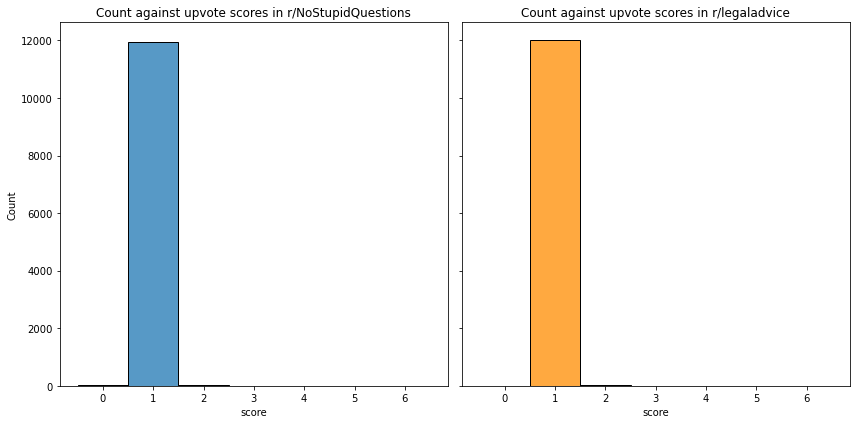

In [13]:
# Compare upvote counts across two subreddits
fig, ax = plt.subplots(1, 2, figsize=(12,6), sharey=True)
ax = ax.ravel()

# Plot histogram plot of upvotes score - nostupid
g1 = sns.histplot(
    data = nostupid,
    x = nostupid["score"],
    ax = ax[0],
    discrete=True
);
g1.set_title("Count against upvote scores in r/NoStupidQuestions");

# Plot histogram plot of upvotes score - legal
g2 = sns.histplot(
    data = legal, 
    x = legal["score"], 
    binrange = [0,6],
    ax = ax[1],
    color='darkorange',
    discrete=True
);
g2.set_title("Count against upvote scores in r/legaladvice");

plt.tight_layout()

It was noted that almost all threads in both subreddits have 1 score. This might suggest that the baseline is 1. It can thus be observed that most posts do not end up getting much upvotes, even though the volume of post is significant.

In [14]:
legal.sort_values(by='upvote_ratio', ascending = True)

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc
10702,throwaway955575579,1,0,0,/r/legaladvice/comments/t2q5mw/i_accidentally_...,0,"Just for context I am 26, in college, and a ve...",legaladvice,I accidentally stole a $30 bottle of pills fro...,0.50,1645974466
1438,bignoobtube,1,0,0,/r/legaladvice/comments/tg9fue/construction_wo...,0,My bedroom is on the first floor facing an all...,legaladvice,Construction workers making a lot of noise usi...,0.50,1647521230
8814,flowerbird96,1,0,0,/r/legaladvice/comments/t5grkl/will_i_get_sued...,0,So I just started my job a few days ago. I sta...,legaladvice,Will I get sued for non compete agreement if I...,0.50,1646274235
2517,jeeplove25,1,0,0,/r/legaladvice/comments/terhfj/how_can_i_preve...,0,I work in an unprofessional office environment...,legaladvice,How can I prevent a PIP in this case?,0.50,1647357876
7151,YamIurQTpie,1,0,0,/r/legaladvice/comments/t7y2dc/16_yr_old_girl_...,0,My (25F) father (50M) invites family members e...,legaladvice,16 yr old girl accusing my dad of being inappr...,0.50,1646570884
8070,Throwfaraway311,1,0,0,/r/legaladvice/comments/t6mwj1/should_i_be_con...,0,I had an -unsavory- relationship when I was yo...,legaladvice,Should I be concerned legally?,0.50,1646411600
6737,PettyWitch,1,0,0,/r/legaladvice/comments/t8o34l/is_it_gender_di...,0,"Location: CT\n\nLong story short, I'm a woman...",legaladvice,Is it gender discrimination when HR celebrates...,0.50,1646655884
11208,SirBacon23,1,0,0,/r/legaladvice/comments/t1np0b/bedroom_securit...,1,Context: I live in Florida with my to-be-divor...,legaladvice,Bedroom Security Camera While on Vacation (FL),0.99,1645848718
1374,CJay35,1,0,0,/r/legaladvice/comments/tgday6/mi_bought_a_hom...,1,In November of 2020 I bought my first home fro...,legaladvice,"[MI] bought a home from a ""flipper""",0.99,1647532308
3118,ivamachine,1,0,0,/r/legaladvice/comments/tdxpiz/i_continually_u...,1,About one year ago I started receiving automat...,legaladvice,I continually unsubscribe from automated texts...,0.99,1647265112


In [15]:
nostupid.sort_values(by='upvote_ratio', ascending = True)

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc
5860,MessageOk9579,1,0,1,/r/NoStupidQuestions/comments/td6891/why_thank...,0,Sounds odd. Why not “thank you body” or “than...,NoStupidQuestions,Why “thank you”?,0.33,1647175657
824,diid8sjejee8ie,1,0,1,/r/NoStupidQuestions/comments/thou01/should_i_...,0,"Right now, have a red slit line in my eyesight...",NoStupidQuestions,should I be worried about this?,0.50,1647669344
8488,Mighty_Krastavac,1,0,3,/r/NoStupidQuestions/comments/taxwmq/why_is_it...,0,IS IT ALL A SCAM?,NoStupidQuestions,Why is it that every time I put a lip balm on ...,0.50,1646916384
2024,DeusExxeMachina,1,0,0,/r/NoStupidQuestions/comments/tgl6qa/the_debat...,0,Reddit what do you think? Are there more wheel...,NoStupidQuestions,The debate continues…wheels or doors???,0.50,1647553509
10943,idkusername0007,1,0,0,/r/NoStupidQuestions/comments/t8v3sm/what_if_y...,0,cannot find a single ounce of information abou...,NoStupidQuestions,what if you make it impossible for a smoker or...,0.50,1646675856
3538,Jazzlike_Brain6101,1,0,1,/r/NoStupidQuestions/comments/tf8jbi/is_it_ill...,0,"A long time ago, I watched the veronica mars ...",NoStupidQuestions,"Is it illegal to lie to 9-1-1 operator, so tha...",0.50,1647402390
3537,throwaway8658197,1,0,0,/r/NoStupidQuestions/comments/tf8jtm/is_ice_cr...,0,You don’t chew it but you also don’t drink it....,NoStupidQuestions,Is ice cream a food or a drink?,0.50,1647402437
3534,Equivalent-Demand460,1,0,2,/r/NoStupidQuestions/comments/tf8ki3/why_are_l...,0,I notice being depressed is a common symptom ...,NoStupidQuestions,Why are low libido or low T men depressed? Pur...,0.50,1647402499
10098,DonTong,1,0,0,/r/NoStupidQuestions/comments/t9kbvw/am_i_the_...,0,Post-nut syndrome doesn't exist.\n\nI'm happy ...,NoStupidQuestions,Am I the only one who feels good after a wank?,0.50,1646756110
384,Significant-Mud-912,1,0,0,/r/NoStupidQuestions/comments/ti3o7m/how_is_it...,0,Last year she was competing as a D1 mens swimm...,NoStupidQuestions,How is it ok for Lia Thomas to compete in wome...,0.50,1647720600


## Data cleaning for `r/NoStupidQuestions` dataframe

### Check for null values

In [16]:
# Check for null values
nostupid.isnull().sum()

author            0
is_self           0
is_video          0
num_comments      0
permalink         0
score             0
selftext        101
subreddit         0
title             0
upvote_ratio      0
created_utc       0
dtype: int64

In [17]:
# Filter dataframe for null value in self text
nostupid[pd.isnull(nostupid['selftext'])]

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc
34,[deleted],1,0,0,/r/NoStupidQuestions/comments/tics37/what_is_a...,1,NaN,NoStupidQuestions,What is a gallery?,0.99,1647749117
263,[deleted],1,0,1,/r/NoStupidQuestions/comments/ti7652/what_shou...,1,NaN,NoStupidQuestions,What should everyone be doing right now that c...,1.00,1647730611
268,[deleted],1,0,1,/r/NoStupidQuestions/comments/ti74x8/whats_som...,1,NaN,NoStupidQuestions,What’s something you surprisingly like about R...,1.00,1647730513
305,[deleted],1,0,1,/r/NoStupidQuestions/comments/ti6a6n/what_are_...,1,NaN,NoStupidQuestions,What are passive suicidal thoughts?,1.00,1647727978
432,[deleted],1,0,0,/r/NoStupidQuestions/comments/ti22cq/how_do_i_...,1,NaN,NoStupidQuestions,How do I make an animated movie without actors?,0.99,1647716095
433,[deleted],1,0,0,/r/NoStupidQuestions/comments/ti21vj/why_is_th...,1,NaN,NoStupidQuestions,Why is that some celebrity offspring are good ...,0.99,1647716057
520,[deleted],1,0,1,/r/NoStupidQuestions/comments/thzntl/on_a_scal...,1,NaN,NoStupidQuestions,"on a scale of 1-10, how fucked up is it to com...",1.00,1647709452
542,[deleted],1,0,0,/r/NoStupidQuestions/comments/thz7b4/is_it_unr...,1,NaN,NoStupidQuestions,Is it unreasonable for me to never feel the sa...,1.00,1647708214
637,[deleted],1,0,1,/r/NoStupidQuestions/comments/thw1ts/can_you_t...,1,NaN,NoStupidQuestions,Can you tell if someone has diabetes (Type2) b...,1.00,1647699209
642,[deleted],1,0,0,/r/NoStupidQuestions/comments/thvynd/is_a_baby...,1,NaN,NoStupidQuestions,Is a baby exactly half sperm and half egg?,1.00,1647698944


Noted that the 101 null entries are due to deletions, either by author or by moderators. As such, we will remove them from the dataframe.

In [18]:
# Drop null values from subreddit dataframe
nostupid.dropna(inplace = True)

In [19]:
# Drop deleted posts
nostupid = nostupid.drop(nostupid[nostupid['selftext']=='[deleted]'].index)

In [20]:
# Check for duplicate postings
nostupid[(nostupid.duplicated(subset=['selftext'])) & (nostupid['selftext'] != '')]\
   .sort_values(ascending=False, by='selftext') \
                ['title'].value_counts()

What is the "Don't say gay" bill exactly?                                                                                                                                                                                                                                                             15
what if you make it impossible for a smoker or a drug addict to access that substance                                                                                                                                                                                                                  5
I made a game winning three at my high school basketball game. This girl started telling people about it in front of me. Then she looked at me and said “ I’m literally advertising for you and you don’t even appreciate me, you should hire me to be your spokesperson.” Why is she saying this?     4
Do I really have to consider him a FWB if we’re not having sex?                                              

There are several instances where the same topic was posted multiple times. It could be due to people reposting the same topic to get a reply, or copying another author's post to get attention from others. I will be removing such duplicates, in order to not feed the same words into the model twice.

In [21]:
# Check for removed posts
nostupid[nostupid['selftext'] == '[removed]']

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc


Noted that there were no removed under selftext.

In [22]:
# Drop duplicate selftext
nostupid.drop_duplicates(subset=['selftext'], inplace = True)

In [23]:
# Check for recurrent authors
nostupid['author'].value_counts()

ToesyToeNails           29
Bluecomments            26
walrusdog32             25
idkman_-_               24
Negative-Term-5574      22
WhoAmIEven2             21
WeirdUniversity136      21
IGotADodoBrain          20
Ok_Meat2719             19
Ilovesweets8            19
ginaia                  18
Ordinary-boy-9765       18
fxactorybridges         17
Veridically_            16
Bubbly_Stretch6790      16
Reasonable_Bag821       15
Chemical_Veteran        14
ThrowawayEARTH32        14
SuccessfulManifests     14
currycheesechip         14
JirohSalonga            14
StarBright465           13
MustBeTheMusic80        13
christmas_tree340       13
wt_anonymous            12
wallpapersdance         12
BroccoliBetter1         12
Edwardo-18              11
Yoyomaster3             11
TheRoyalDon             11
Fruitsalad_is_tasty     11
MothThatLuvsLamps       11
rainbow_bro_bot         10
throawaysfv1307         10
EmbarrassedLobster37    10
keanuDaOne              10
Maleficent-Ad7330       10
f

There doesn't seem to be specific authors who are mass posting, or automatically posting. Highest posting is 29, which looks possible if the person is an active user on the subreddit. As such, I infer that there are no moderator bots or posting bots.

## Data cleaning for `legaladvice` dataframe

In [24]:
# Check for null values
legal.isnull().sum()

author          0
is_self         0
is_video        0
num_comments    0
permalink       0
score           0
selftext        1
subreddit       0
title           0
upvote_ratio    0
created_utc     0
dtype: int64

In [25]:
# Filter dataframe for null value in self text
legal[pd.isnull(legal['selftext'])]

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc
11644,[deleted],1,0,0,/r/legaladvice/comments/t0xjik/airbnb_camera/,1,NaN,legaladvice,Airbnb camera,1.0,1645772154


Null entry is due to deletion, either by author or by moderators. As such, we will remove it from the dataframe.

In [26]:
# Drop null values from subreddit dataframe
legal.dropna(inplace = True)

In [27]:
# Check for duplicate postings
legal[(legal.duplicated(subset=['selftext'])) & (legal['selftext'] != '')]\
            .sort_values(ascending=False, by='selftext') \
                ['title'].value_counts()

Am I entitled to my holiday pay?                                                                                                                                                                                                                                                                               2
What should I do next?                                                                                                                                                                                                                                                                                         2
Emergency Transport on a Helicopter - Insurance does not was to to pay                                                                                                                                                                                                                                         1
[Illinois] New Landlord Plans to Sell Next Year, Not Fulfilling Maintenance This Year

There are several instances where the same topic was posted multiple times. It could be due to people reposting the same topic, or copying another author's post. I will be removing such duplicates.

In [28]:
# Drop duplicate selftext
legal.drop_duplicates(subset=['selftext'], inplace = True)

In [29]:
# Check for recurrent authors
legal['author'].value_counts()

Dzenis1000              30
Lake216                  6
CommitteeOk403           6
Appropriate-Sun1525      5
throwaway31223954        5
Veunouss9                5
SenexFox                 5
GreenEyes_BlueSkies      4
debtmistakes             4
cold_cash_devine         4
Intelligent-Bottle22     4
No-Mud-8971              4
Shkmstr                  4
Level_Jackfruit9470      4
Morvano                  4
ShiirosWorstenemy        4
MargeSimpson111          4
Uninhibitedrmr           4
Dustiegirl               4
smugglerdeakins          4
HowTheTruthFeel          4
zachismyname1            4
CantStopPoppin           4
Impressive-Pack6797      4
SakarPhone               3
AngryOptics              3
MinervaMinkMink          3
diesel6991               3
femalefirefighter56      3
gypsy-girl21             3
SticklessTreee           3
meeoomii_2021            3
Training_Entrance_88     3
Pixiplanet               3
Odd-Reaction-9428        3
Full-Comedian-749        3
anxioussdog              3
M

There doesn't seem to be specific authors who are mass posting, or automatically posting. Highest posting is 30, which looks possible if the person is an active user on the subreddit. As such, I infer that there are no moderator bots or posting bots.

In [30]:
# Check for removed posts
legal[legal['selftext'] == '[removed]']

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc


Noted that there were no removed under selftext.

## Preprocessing

I have used the below functions below to help to drop links, remove emoticons that are common, remove html markers and punctuation as well as to help lemmatize the text.

In [31]:
def drop_links(text):
    words = text.split(' ')
    words_to_sub = [w for w in words if 'http' in w]
    
    if words_to_sub:
        for w in words_to_sub:
            new_word = re.sub('http.*', '', w)
            text = re.sub(w, new_word, text)
        return text
        
    # If no links in post, return text   
    return text

In [32]:
def preprocessing(text):
            
    # Remove new lines
    text = text.replace('\n',' ').lower()
    
    # Remove emoticons
    text = re.sub(':d', '', str(text)).strip()
    text = re.sub(':p', '', str(text)).strip()
    
    # Remove HTML markers and punctuation
    text = re.sub('xa0', '', str(text)).strip()
    text = re.sub('x200b', '', str(text)).strip()
    text = re.sub('[^a-zA-Z\s]', '', str(text)).strip() 
    
    return text

In [33]:
stop_word_set = set(CountVectorizer(stop_words = 'english').get_stop_words())

def lemmatize(text):
    # Change each word to a string to prepare for lemmatization
    words = text.split(' ')
    
    # Lemmatize and apply stopwords.
    lemmatizer = WordNetLemmatizer()
    meaningful_words = [lemmatizer.lemmatize(w) for w in words if not w in stop_word_set]
    
    return(" ".join(meaningful_words))

In [34]:
# Removing new lines, removing punctuation and tokenizing text for nostupid
nostupid['cleaned_title'] = nostupid['title'].apply(preprocessing)
nostupid['cleaned_selftext'] = nostupid['selftext'].apply(preprocessing)


# Removing new lines, removing punctuation and tokenizing text for legaladvice
legal['cleaned_title'] = legal['title'].apply(preprocessing)
legal['cleaned_selftext'] = legal['selftext'].apply(preprocessing)

In [35]:
# Dropping links
nostupid['cleaned_selftext'] = nostupid['cleaned_selftext'].apply(drop_links)
legal['cleaned_selftext'] = legal['cleaned_selftext'].apply(drop_links)

In [36]:
# Combining title and selftext
nostupid['combi_text'] = nostupid['cleaned_title'] + ' ' + nostupid['cleaned_selftext']
legal['combi_text'] = legal['cleaned_title'] + ' ' + legal['cleaned_selftext']

In [37]:
# Lemmatizing text for nostupid & legaladvice
nostupid['lem_title'] = nostupid['cleaned_title'].apply(lemmatize, True)
nostupid['lem_selftext'] = nostupid['cleaned_selftext'].apply(lemmatize, True)
nostupid['lem_combi_text'] = nostupid['lem_title'] + ' ' + nostupid['lem_selftext']

legal['lem_title'] = legal['cleaned_title'].apply(lemmatize, True)
legal['lem_selftext'] = legal['cleaned_selftext'].apply(lemmatize, True)
legal['lem_combi_text'] = legal['lem_title'] + ' ' + legal['lem_selftext']

In [38]:
# Comparing lemmatized vs regular text 
# Nuance within the post has been lost after lemmatization 
print(nostupid['combi_text'][0], '\n')
print(nostupid['lem_combi_text'][0])

is different human behaviours occur because of the way they are raised or is it because they are born like that suppose we kidnap  infant babies all of different cultures ethnicity and religion from all around the world and put them in an artificially simulated enviornment they are raised by identical robot parents thats gonna have the same personality and teach them the same things they are all gonna be out in an artificial school with artificial friends lovers bullies whos gonna give them the same experience  my point is they will have a perfectly identical life so when they reach adulthood will this  babies be the exact copy of others behaviouraly 

different human behaviour occur way raised born like suppose kidnap  infant baby different culture ethnicity religion world artificially simulated enviornment raised identical robot parent thats gonna personality teach thing gonna artificial school artificial friend lover bully who gonna experience  point perfectly identical life reach a

Lemmatized and non lemmatized text will be evaluated on model selection, to see which gives better accuracy.

## EDA on `selftext` and `title`

### `selftext` and `title` length - before lemmatizing and stopwords removal (ie. `combi_text` length)

In [39]:
# Create length column based on combined text column - containing selftext and title
nostupid['length_combi_text'] = nostupid['combi_text'].str.len()
legal['length_combi_text'] = legal['combi_text'].str.len()

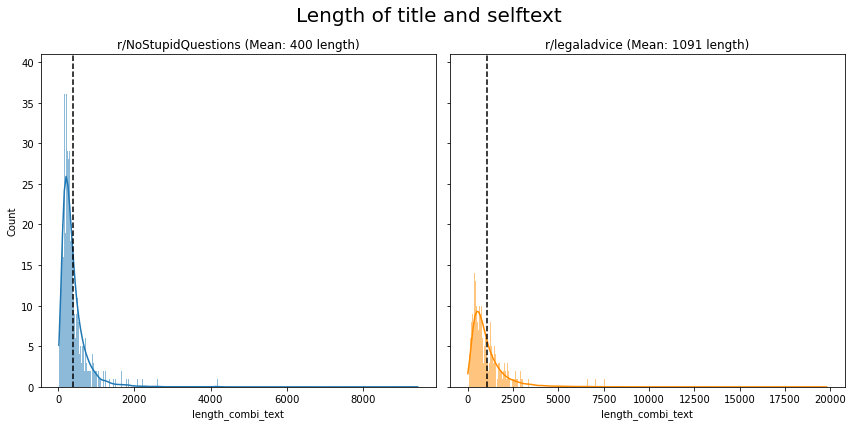

In [40]:
# Compare length in selftext and title across two subreddits before lemmatizing and stopwords removal
fig, ax = plt.subplots(1, 2, figsize=(12,6), sharey=True)
ax = ax.ravel()

# Plot histogram plot of length - nostupid
g1 = sns.histplot(
    data = nostupid,
    x = nostupid["length_combi_text"],
    ax = ax[0],
    kde = True,
    discrete=True
);
mean_1 = nostupid['length_combi_text'].mean()
g1.set_title(f'r/NoStupidQuestions (Mean: {round(mean_1)} length)')
ax[0].axvline(mean_1, ls='--', color='black')

# Plot histogram plot of length - legal
g2 = sns.histplot(
    data = legal, 
    x = legal["length_combi_text"], 
    ax = ax[1],
    kde = True,
    color='darkorange',
    discrete=True
);
mean_2 = legal['length_combi_text'].mean()
g2.set_title(f'r/legaladvice (Mean: {round(mean_2)} length)')
ax[1].axvline(mean_2, ls='--', color='black')

plt.suptitle('Length of title and selftext', fontsize=20);
plt.tight_layout()

We can see from the histograms above, `r/legaladvice` tends to have longer `title` and `selftext` length than `r/NoStupidQuestion` postings (`r/legaladvice` mean: 1,091 versus `r/NoStupidQuestion` mean: 400). 

#### Possible explanations 
1) This might due to the necessity for the author to include the context and background of the queries, in order to get a more accurate response from others. 

2) It might also potentially be due to legal jargons being more lengthy is letters compared to normal questions.

I will be performing the same step after removing common english stop words and lemmatizing.

### `selftext` and `title` length - after lemmatizing and stopwords removal (ie. `lem_combi_text` length)

In [41]:
# Create column with word length based on combined lemmatized and
# stop word removed text column - containing selftext and title
nostupid['length_lem_combi_text'] = nostupid['lem_combi_text'].str.len()
legal['length_lem_combi_text'] = legal['lem_combi_text'].str.len()

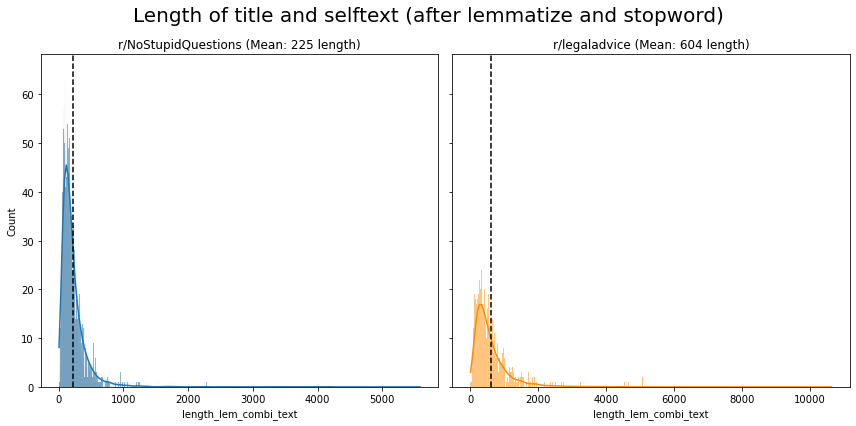

In [42]:
# Compare length in selftext and title across two subreddits - after lemmatizing and stopword
fig, ax = plt.subplots(1, 2, figsize=(12,6), sharey=True)
ax = ax.ravel()

# Plot histogram plot of length - nostupid
g1 = sns.histplot(
    data = nostupid,
    x = nostupid["length_lem_combi_text"],
    ax = ax[0],
    kde = True,
    discrete=True
);
mean_1 = nostupid['length_lem_combi_text'].mean()
g1.set_title(f'r/NoStupidQuestions (Mean: {round(mean_1)} length)')
ax[0].axvline(mean_1, ls='--', color='black')

# Plot histogram plot of length - legal
g2 = sns.histplot(
    data = legal, 
    x = legal["length_lem_combi_text"], 
    ax = ax[1],
    kde = True,
    color='darkorange',
    discrete=True
);
mean_2 = legal['length_lem_combi_text'].mean()
g2.set_title(f'r/legaladvice (Mean: {round(mean_2)} length)')
ax[1].axvline(mean_2, ls='--', color='black')

plt.suptitle('Length of title and selftext (after lemmatize and stopword)', fontsize=20);
plt.tight_layout()

Similarly, the length after stop word and lemmatizing is still significantly higher in `r/legaladvice` than `r/NoStupidQuestions`. This shows that the words that were added into posts in legal queries are not simply common english stop words, but additional words that give meaning to the questions that are asked. 

It is noted that before lemmatizing and stop words removal, the difference in mean is 691 in length (1,091 - 400), but after lemmatizing and stop words removal, the difference in mean closed up to 379 in length (604 - 225). This likely shows that proposed longer text caused by the writing of the background or context in the `selftext` uses many commonly used english words and tenses that did not bring extra meaning to the sentence.

### `selftext` and `title` word counts before lemmatizing and stopwords removal (ie. `combi_text` word count)

In [43]:
# Create word count column based on combined text column - containing selftext and title
nostupid['wcount_combi_text'] = nostupid['combi_text'].apply(lambda x: len(str(x).split(' ')))
legal['wcount_combi_text'] = legal['combi_text'].apply(lambda x: len(str(x).split(' ')))

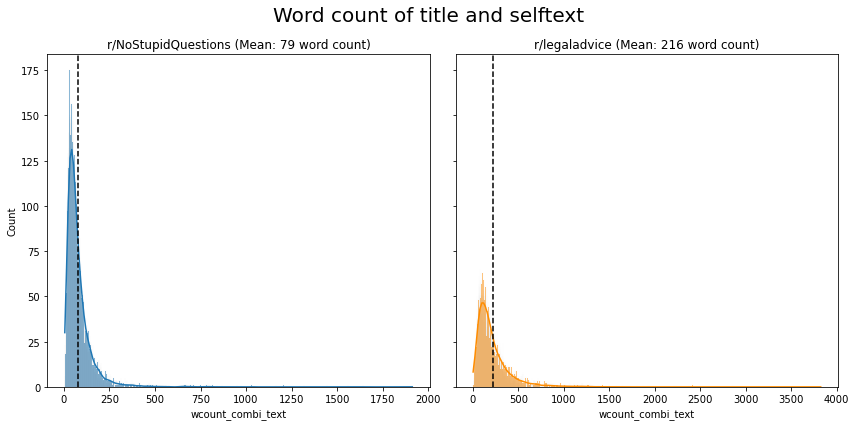

In [44]:
# Compare word count in selftext and title across two subreddits - before lemmatizing and stopword
fig, ax = plt.subplots(1, 2, figsize=(12,6), sharey=True)
ax = ax.ravel()

# Plot histogram plot of word count - nostupid
g1 = sns.histplot(
    data = nostupid,
    x = nostupid["wcount_combi_text"],
    ax = ax[0],
    kde = True,
    discrete=True
);
mean_1 = nostupid['wcount_combi_text'].mean()
g1.set_title(f'r/NoStupidQuestions (Mean: {round(mean_1)} word count)')
ax[0].axvline(mean_1, ls='--', color='black')

# Plot histogram plot of word count - legal
g2 = sns.histplot(
    data = legal, 
    x = legal["wcount_combi_text"], 
    ax = ax[1],
    kde = True,
    color='darkorange',
    discrete=True
);
mean_2 = legal['wcount_combi_text'].mean()
g2.set_title(f'r/legaladvice (Mean: {round(mean_2)} word count)')
ax[1].axvline(mean_2, ls='--', color='black')

plt.suptitle('Word count of title and selftext', fontsize=20);
plt.tight_layout()

Not surprisingly, the same trend is noted for word count, showing more evidence that it is due to more words used to give context and background.

### `selftext` and `title` word counts after lemmatizing and stopwords removal (ie. `lem_combi_text` word count)

In [45]:
# Create word count column based on combined text column - containing selftext and title
nostupid['wcount_lem_combi_text'] = nostupid['lem_combi_text'].apply(lambda x: len(str(x).split(' ')))
legal['wcount_lem_combi_text'] = legal['lem_combi_text'].apply(lambda x: len(str(x).split(' ')))

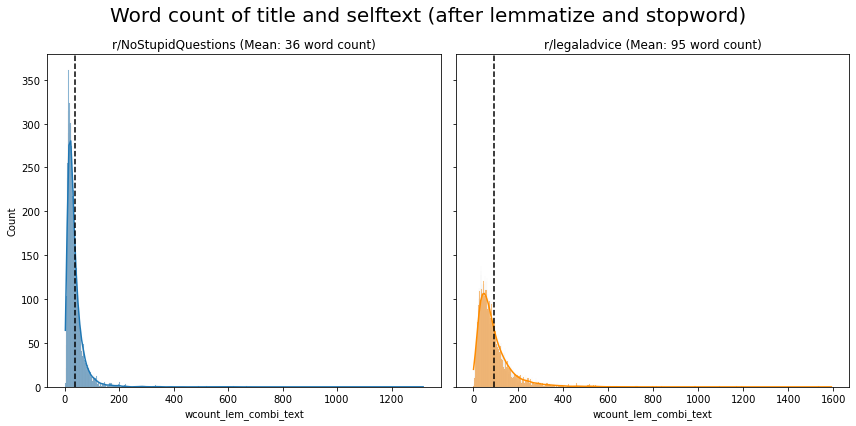

In [46]:
# Compare word count in selftext and title across two subreddits - after lemmatizing and stopword
fig, ax = plt.subplots(1, 2, figsize=(12,6), sharey=True)
ax = ax.ravel()

# Plot histogram plot of word count - nostupid
g1 = sns.histplot(
    data = nostupid,
    x = nostupid["wcount_lem_combi_text"],
    ax = ax[0],
    kde = True,
    discrete=True
);
mean_1 = nostupid['wcount_lem_combi_text'].mean()
g1.set_title(f'r/NoStupidQuestions (Mean: {round(mean_1)} word count)')
ax[0].axvline(mean_1, ls='--', color='black')

# Plot histogram plot of word count - legal
g2 = sns.histplot(
    data = legal, 
    x = legal["wcount_lem_combi_text"], 
    ax = ax[1],
    kde = True,
    color='darkorange',
    discrete=True
);
mean_2 = legal['wcount_lem_combi_text'].mean()
g2.set_title(f'r/legaladvice (Mean: {round(mean_2)} word count)')
ax[1].axvline(mean_2, ls='--', color='black')

plt.suptitle('Word count of title and selftext (after lemmatize and stopword)', fontsize=20);
plt.tight_layout()

Similarly, the same trend is noted for word count after lemmatizing and stopwords removal. For both before lemmatizing and stopwords removal, `r/legaladvice` are close to three times longer in word count compared to `r/NoStupidQuestions` on average.  

### Longest `title` and `selftext`

I chosen to filter the longest `title` with `selftext` with word count of lematized and stopword removed text to look at the top 5 longest posts. Based on the EDA, the longest post should be the same whether it is filterd before or after lematizing and stopword removal, and should also be the same through word count and length. As such, I will only perform this once, as I am not expecting to gain further insights by sorting other columns.

In [47]:
nostupid.sort_values('wcount_lem_combi_text',ascending = False).head()

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc,cleaned_title,cleaned_selftext,combi_text,lem_title,lem_selftext,lem_combi_text,length_combi_text,length_lem_combi_text,wcount_combi_text,wcount_lem_combi_text
8747,Smooth-Ocelot-5086,1,0,0,/r/NoStupidQuestions/comments/taop95/привет_до...,1,привет добро пожаловать в макдональдс ты очень...,NoStupidQuestions,привет добро пожаловать в макдональдс?,1.0,1646880738,,cletus yeehawus yeehawus ...,cletus yeehawus yeehawus ...,,cletus yeehawus yeehawus ...,cletus yeehawus yeehawus ...,1798,1798,1316,1316
10367,Difficult-Show8063,1,0,0,/r/NoStupidQuestions/comments/t9b3nh/where_did...,1,Most great civilizations were fed grain. It i...,NoStupidQuestions,Where did grain come from?,1.0,1646723145,where did grain come from,most great civilizations were fed grain it is...,where did grain come from most great civilizat...,did grain come,great civilization fed grain cheap easy store...,did grain come great civilization fed grain c...,9427,5582,1912,980
3810,bubbztea,1,0,0,/r/NoStupidQuestions/comments/tf0hnq/should_i_...,1,I (21F) am done with my father.\n\nMy dad was ...,NoStupidQuestions,Should I just disown my dad?,1.0,1647378735,should i just disown my dad,i f am done with my father my dad was sent fr...,should i just disown my dad i f am done with m...,just disown dad,f father dad sent ireland brother sister cana...,just disown dad f father dad sent ireland bro...,8013,4200,1641,667
11758,Fruitless-Effort,1,0,0,/r/NoStupidQuestions/comments/t86qdk/i_have_a_...,1,"Sadly, this is my first post on Reddit, so if ...",NoStupidQuestions,I have a question about something abstract.,1.0,1646596101,i have a question about something abstract,sadly this is my first post on reddit so if i ...,i have a question about something abstract sad...,question abstract,sadly post reddit violate rule apologize try b...,question abstract sadly post reddit violate ru...,7519,4185,1446,629
11570,Responsible-Comb-317,1,0,0,/r/NoStupidQuestions/comments/t8bkcz/what_are_...,1,# TOP 6 Major Red Flags in NFT Projects\n\n**W...,NoStupidQuestions,What are the most common mistakes that people ...,1.0,1646609670,what are the most common mistakes that people ...,top major red flags in nft projects when you...,what are the most common mistakes that people ...,common mistake people make invest nfts,major red flag nft project enter nft market ...,common mistake people make invest nfts major ...,6455,4232,1164,619


The longest post in `r/NoStupidQuestions` contains `selftext` from a different language, and `title` with a long string of vulgarities. Other long posts are also due to explanation of the context and background. A couple of posts are long as they are meant to rant and vent frustrations of the author, and others to give others an answer based on their own preformed opinion which is not really written as a question.

In [48]:
legal.sort_values('wcount_lem_combi_text',ascending = False).head()

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc,cleaned_title,cleaned_selftext,combi_text,lem_title,lem_selftext,lem_combi_text,length_combi_text,length_lem_combi_text,wcount_combi_text,wcount_lem_combi_text
7650,0Charkell0,1,0,0,/r/legaladvice/comments/t75n3f/feeling_helples...,1,"Hello everyone, this story is pretty lengthy b...",legaladvice,Feeling helpless and am stuck,1.0,1646471387,feeling helpless and am stuck,hello everyone this story is pretty lengthy bu...,feeling helpless and am stuck hello everyone t...,feeling helpless stuck,hello story pretty lengthy im going try conden...,feeling helpless stuck hello story pretty leng...,19786,10625,3826,1592
2451,Huge-Maintenance-967,1,0,0,/r/legaladvice/comments/teuhrw/death_threat_at...,1,I work in a mental institution as a peer suppo...,legaladvice,Death threat at work,1.0,1647365450,death threat at work,i work in a mental institution as a peer suppo...,death threat at work i work in a mental instit...,death threat work,work mental institution peer support specialis...,death threat work work mental institution peer...,15242,8542,3152,1535
822,Hot-Loquat-4145,1,0,0,/r/legaladvice/comments/th4ha8/eeoc_investigat...,1,I’m not sure what this would classify as; if a...,legaladvice,EEOC investigations now involved - I’m terrifi...,1.0,1647618768,eeoc investigations now involved im terrified,im not sure what this would classify as if any...,eeoc investigations now involved im terrified...,eeoc investigation involved im terrified,im sure classify starting panic attack regular...,eeoc investigation involved im terrified im s...,14081,7865,2866,1278
4773,chasingmarrakech,1,0,0,/r/legaladvice/comments/tbbq99/sexual_assault_...,1,"This is in Toronto, ON. Canada\n\nHi there.\n\...",legaladvice,Sexual Assault + Emotional Manipulation/ Abuse,1.0,1646953709,sexual assault emotional manipulation abuse,this is in toronto on canada hi there please...,sexual assault emotional manipulation abuse t...,sexual assault emotional manipulation abuse,toronto canada hi bare lengthy post thank re...,sexual assault emotional manipulation abuse t...,13522,7219,2852,1193
5934,doctrangle,1,0,0,/r/legaladvice/comments/t9qxpv/wretched_housem...,1,"Hey reddit. I'm a longtime lurker, first time...",legaladvice,"Wretched Housemate in California, How to Evict...",1.0,1646773628,wretched housemate in california how to evict ...,hey reddit im a longtime lurker first time po...,wretched housemate in california how to evict ...,wretched housemate california evict master ten...,hey reddit im longtime lurker time poster sub...,wretched housemate california evict master ten...,12352,7166,2416,1170


Upon looking at the longest posts, the `selftext` is observed to be long due to dialogues, key dates, thoughts, and strong emotional words being included in the text.

### Shortest `title` and `selftext`

In [49]:
nostupid.sort_values('wcount_lem_combi_text',ascending = False).tail()

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc,cleaned_title,cleaned_selftext,combi_text,lem_title,lem_selftext,lem_combi_text,length_combi_text,length_lem_combi_text,wcount_combi_text,wcount_lem_combi_text
1440,TA8381,1,0,0,/r/NoStupidQuestions/comments/th38pn/where_was...,1,https://vm.tiktok.com/ZTdfGQg6g/,NoStupidQuestions,Where was this filmed?,1.0,1647615419,where was this filmed,,where was this filmed,filmed,,filmed,22,7,5,2
4355,Administrative_Key48,1,0,0,/r/NoStupidQuestions/comments/tegrx2/the_snatch/,1,What is it,NoStupidQuestions,The snatch,1.0,1647318756,the snatch,what is it,the snatch what is it,snatch,,snatch,21,7,5,2
5397,nyetdrocheet,1,0,1,/r/NoStupidQuestions/comments/tdjohz/what_is_t...,1,https://imgur.com/a/SA5KP06,NoStupidQuestions,What is this symbol?,1.0,1647214550,what is this symbol,,what is this symbol,symbol,,symbol,20,7,5,2
3265,Old-Dinner1850,1,0,0,/r/NoStupidQuestions/comments/tfid6h/how_many_...,1,Me. None :/,NoStupidQuestions,How many friends do you have?,1.0,1647439323,how many friends do you have,me none,how many friends do you have me none,friend,,friend,36,7,8,2
3938,KurriGohan,1,0,0,/r/NoStupidQuestions/comments/tew2gx/how_do_i_...,1,How do I type this ?,NoStupidQuestions,How do I type this ?,1.0,1647368724,how do i type this,how do i type this,how do i type this how do i type this,type,type,type type,37,9,10,2


For the shortest few posts in `r/NoStupidQuestions`, the questions asked are very simplistic and are only asking for a simple response. As such they are generally kept short.

In [50]:
legal.sort_values('wcount_lem_combi_text',ascending = False).tail()

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc,cleaned_title,cleaned_selftext,combi_text,lem_title,lem_selftext,lem_combi_text,length_combi_text,length_lem_combi_text,wcount_combi_text,wcount_lem_combi_text
10619,moonstarice,1,0,0,/r/legaladvice/comments/t2vjar/how_do_i_find_o...,1,Kids involved.,legaladvice,How do I find out if my marriage is fake/invalid?,1.00,1645989513,how do i find out if my marriage is fakeinvalid,kids involved,how do i find out if my marriage is fakeinvali...,marriage fakeinvalid,kid involved,marriage fakeinvalid kid involved,61,33,12,4
8406,DinosaursPicnic,1,0,0,/r/legaladvice/comments/t6208i/is_there_anythi...,1,[this abuse right here](https://www.facebook.c...,legaladvice,Is there anything that can be done about this?,1.00,1646342340,is there anything that can be done about this,this abuse right here,is there anything that can be done about this ...,,abuse right,abuse right,67,12,13,3
7543,Specialist_Cod_1835,1,0,0,/r/legaladvice/comments/t7cxiy/karma/,1,Please how can I get more karma points?,legaladvice,Karma,1.00,1646497345,karma,please how can i get more karma points,karma please how can i get more karma points,karma,karma point,karma karma point,44,17,9,3
486,insanewe,1,0,0,/r/legaladvice/comments/thlkah/swordfish/,1,yes ues,legaladvice,swordfish,0.99,1647657120,swordfish,yes ues,swordfish yes ues,swordfish,yes ues,swordfish yes ues,17,17,3,3
509,Mybigthumb,1,0,0,/r/legaladvice/comments/thkixl/testing/,1,Hello,legaladvice,Testing,1.00,1647653620,testing,hello,testing hello,testing,hello,testing hello,13,13,2,2


For the shortest posts in `r/legaladvice` they tend to not give any context, and therefore do not end up getting any responses. It was also noted that some of the posts are troll postings that are not really legal queries. As such, I can infer that most of the shortest postings are not really meaningful legal queries.

## Stopwords

I will be investigating the top 10 used words for both subreddits using both CountVectorizer and TF-IDF Vectorizer. Stopwords used will be based on common english stop words as well as words that are contained in the subreddit names. The same stopwords would be reused on the two vectorizers.

In [51]:
# Use default english stopwords
custom_stopwords = stopwords.words('english')

In [52]:
# Create list of new words to extend stopwords list
new_words = ['legal',
             'advice',
             'advices',
             'stupid',
             'no',
             'question',
             'questions',
             'ive',
             'im',
             'like'
            ]

In [53]:
# Add new words into custom stopwords list
custom_stopwords.extend(new_words)

In [54]:
# Print custom_stopwords to view list used
custom_stopwords

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [55]:
# Instantiate CountVectorizer, keep features at 10 as interested to see top 10
cvec = CountVectorizer(max_features = 10,
                       stop_words = custom_stopwords)

In [56]:
# Create function to get top words using CVEC and plot
# External research done from: 
# https://medium.com/@cristhianboujon/how-to-list-the-most-common-words-from-text-corpus-using-scikit-learn-dad4d0cab41d
def plot_top_words(df, col, n, n_gram_range, title, color):
    def get_top_n_words(corpus, n=n, k=n_gram_range):     
        vec = CountVectorizer(ngram_range=(k,k), stop_words = custom_stopwords).fit(corpus)     
        bag_of_words = vec.transform(corpus)     
        sum_words = bag_of_words.sum(axis=0)      
        words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]    
        words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True) 
        return words_freq[:n]
    temp_df = pd.DataFrame(data=get_top_n_words(df[col], n), columns=['word','freq'])
    plt.figure(figsize=(10,6))
    sns.barplot(data=temp_df, y='word', x='freq', color=color)
    plt.title(title, fontsize=18)

## Top 10 common words for `r/NoStupidQuestions` by CountVectorizer


### Before lemmatizing

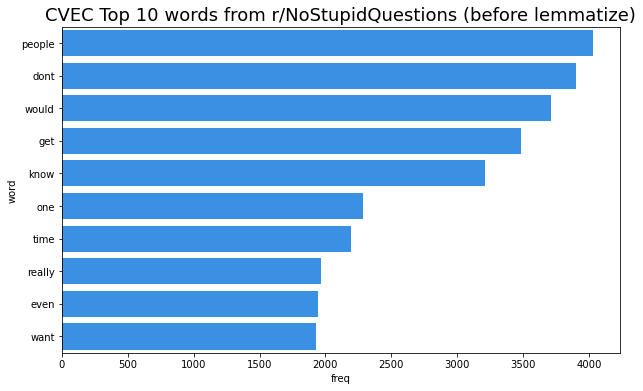

In [57]:
# Display top 10 common words for subreddit before lemmatizing
plot_top_words(nostupid,
               'combi_text',
               10,
               1,
               'CVEC Top 10 words from r/NoStupidQuestions (before lemmatize)',
               'dodgerblue')

### After lemmatizing

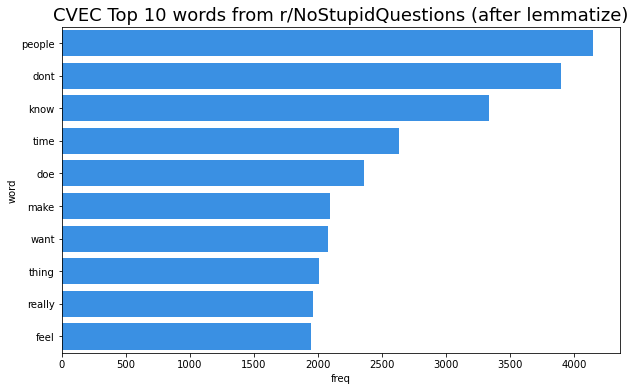

In [58]:
# Display top 10 common words for subreddit after lemmatizing
plot_top_words(nostupid,
               'lem_combi_text',
               10,
               1,
               'CVEC Top 10 words from r/NoStupidQuestions (after lemmatize)',
               'dodgerblue')

The common thread amongst the words that commonly appear within this subreddit are related to people, feelings, action and time. The word choices tend to be generic and conversational.

## Top 10 common words for `r/legaladvice` by CountVectorizer

### Before lemmatizing

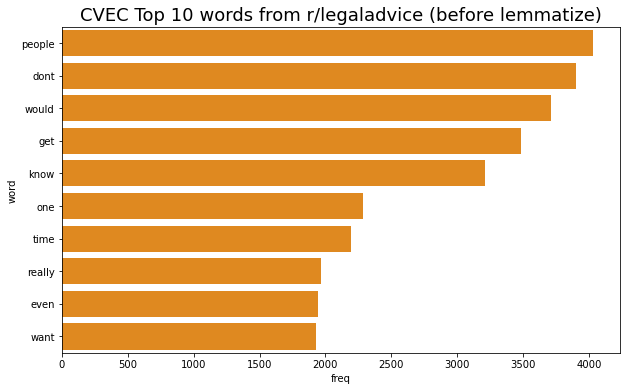

In [59]:
# Display top 10 common words for subreddit before lemmatizing
plot_top_words(nostupid,
               'combi_text',
               10,
               1,
               'CVEC Top 10 words from r/legaladvice (before lemmatize)',
               'darkorange')

### After lemmatizing

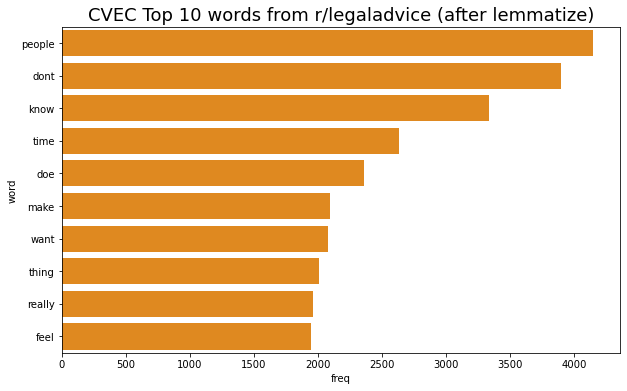

In [60]:
# Display top 10 common words for subreddit after lemmatizing
plot_top_words(nostupid,
               'lem_combi_text',
               10,
               1,
               'CVEC Top 10 words from r/legaladvice (after lemmatize)',
               'darkorange')

Alot more occurences of time related words like 'day', 'month', 'year', 'time' comes up. On top of that words like 'told', 'say', 'know', 'would' are commonly used words that could be used to describe the context and the question better.

## TF-IDF Vectorizer and top 10 used words

Term Frequency-Inverse Document Frequency (TF-IDF) Vectorizer  overcomes a limitation of CountVectorizer, which simply give a count, by focusing on important words that appear on often in one document but don't appear in many documents. It is expected to have more predictive power especially when terminologies and jargons are commonly used in law.

It was interesting to note that for both r/NoStupidQuestions and r/legaladvice, the top 10 common words are the same for TF-IDF and CountVectorizer. Only the order changed, showing that there is no dispute what the most common words are.

In [61]:
# Create function to get top words using TF-IDF Vectorizer and plot
# External research done from: 
# https://medium.com/@cristhianboujon/how-to-list-the-most-common-words-from-text-corpus-using-scikit-learn-dad4d0cab41d
def plot_top_words_tfidf(df, col, n, n_gram_range, title, color):
    def get_top_n_words_tfidf(corpus, n=n, k=n_gram_range):     
        tvec = TfidfVectorizer(ngram_range=(k,k), stop_words=custom_stopwords).fit(corpus)     
        bag_of_words = tvec.transform(corpus)     
        sum_words = bag_of_words.sum(axis=0)      
        words_freq = [(word, sum_words[0, idx]) for word, idx in tvec.vocabulary_.items()]    
        words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True) 
        return words_freq[:n]
    temp_df = pd.DataFrame(data=get_top_n_words_tfidf(df[col], n), columns=['word','freq'])
    plt.figure(figsize=(10,6))
    sns.barplot(data=temp_df, y='word', x='freq', color=color)
    plt.title(title, fontsize=18)

## Top 10 common words for r/NoStupidQuestions by TF-IDF Vectorizer

### Before lemmatizing

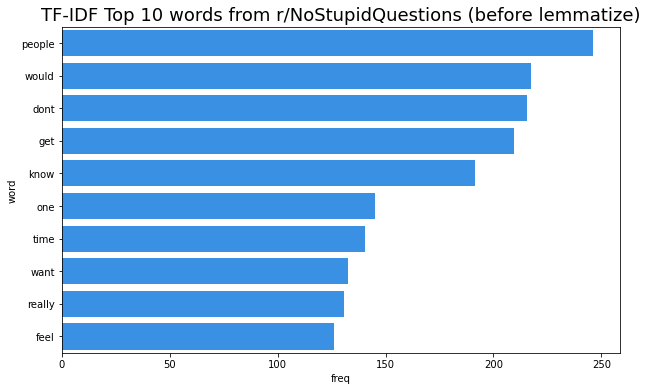

In [62]:
# Display top 10 common words for subreddit before lemmatizing
plot_top_words_tfidf(nostupid,
               'combi_text',
               10,
               1,
               'TF-IDF Top 10 words from r/NoStupidQuestions (before lemmatize)',
               'dodgerblue')

### After lemmatizing

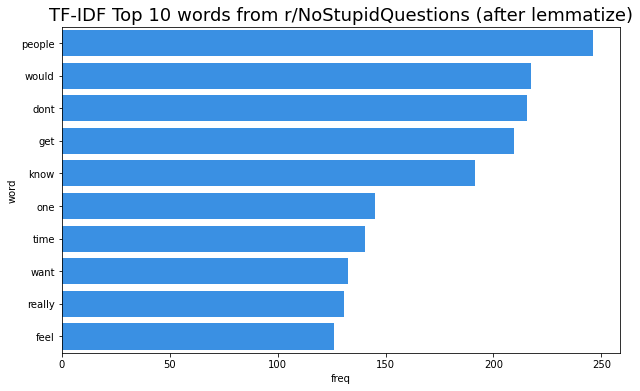

In [63]:
# Display top 10 common words for subreddit after lemmatizing
plot_top_words_tfidf(nostupid,
               'combi_text',
               10,
               1,
               'TF-IDF Top 10 words from r/NoStupidQuestions (after lemmatize)',
               'dodgerblue')

## Top 10 common words for r/legaladvice by TF-IDF Vectorizer

### Before lemmatizing

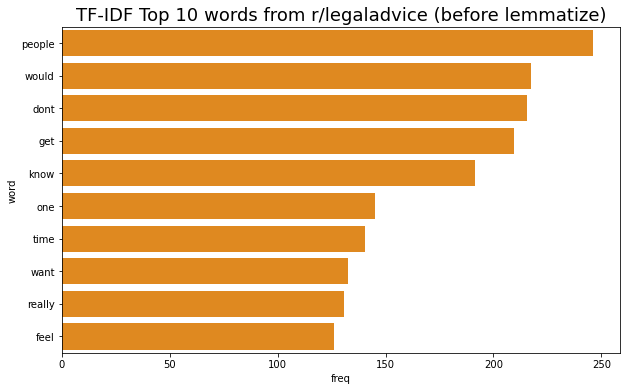

In [64]:
# Display top 10 common words for subreddit before lemmatizing
plot_top_words_tfidf(nostupid,
               'combi_text',
               10,
               1,
               'TF-IDF Top 10 words from r/legaladvice (before lemmatize)',
               'darkorange')

### After lemmatizing

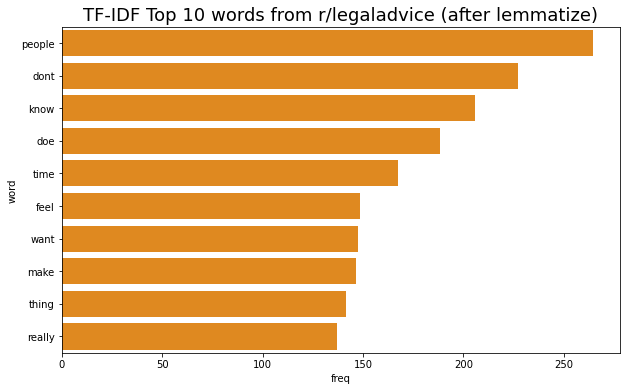

In [65]:
# Display top 10 common words for subreddit after lemmatizing
plot_top_words_tfidf(nostupid,
               'lem_combi_text',
               10,
               1,
               'TF-IDF Top 10 words from r/legaladvice (after lemmatize)',
               'darkorange')

### Insight from comparing top used words by CVEC and TFIDF
The words are the same, and it is merely the order that is changed. As such, when assessing N-grams; bigrams and trigrams specifically, I will just be using CountVectorizer to assess as it is unlikely that anything insightful will come out of performing TF-IDF again for N-grams analysis.

I have opted not to use lemmatized text as lemmatizing could potentially change the meaning of phrases, and I want to make observations of actual phrases and the context they are used.

## N-grams

### Bigrams

### `r/NoStupidQuestions` bigrams

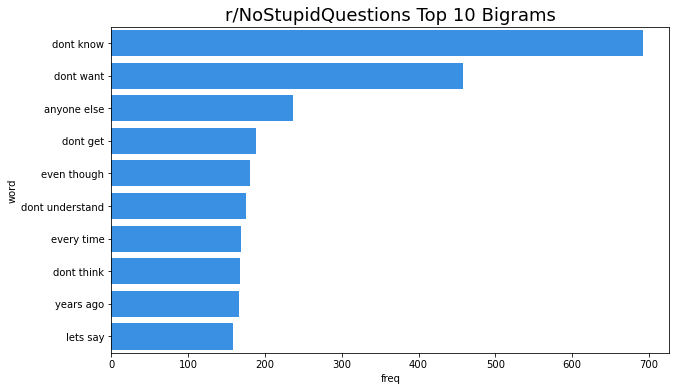

In [66]:
plot_top_words(nostupid,
               'combi_text', 
               10, 
               2, 
               'r/NoStupidQuestions Top 10 Bigrams',
               'dodgerblue')

### `r/legaladvice` bigrams

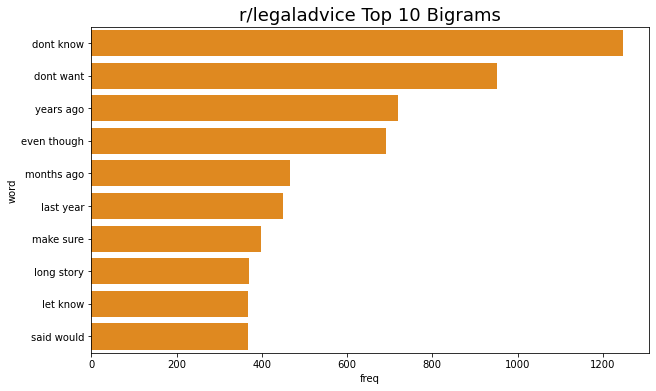

In [67]:
plot_top_words(legal,
               'combi_text', 
               10, 
               2, 
               'r/legaladvice Top 10 Bigrams',
               'darkorange')

It was consistent across both subreddits that 'dont know', 'dont want', 'years ago' appeared as top 10 bigrams. There is no other clear trends when comparing the bigrams of both subreddit, other than r/legaladvice having 'months ago', 'years ago' and 'last year' which are descriptive phrases about specific timing, possibly to illustrate the background in full, including the timings. 

## Trigrams

### `r/NoStupidQuestions` trigrams

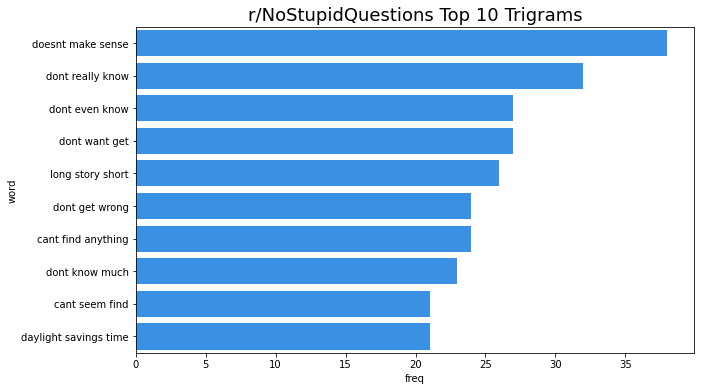

In [68]:
plot_top_words(nostupid,
               'combi_text', 
               10, 
               3, 
               'r/NoStupidQuestions Top 10 Trigrams',
               'dodgerblue')

It is interesting to note that 7 out of 10 of top 10 trigrams in r/NoStupidQuestions are qualifiers made on the author's knowlege on the topic. 

### `r/legaladvice` trigrams

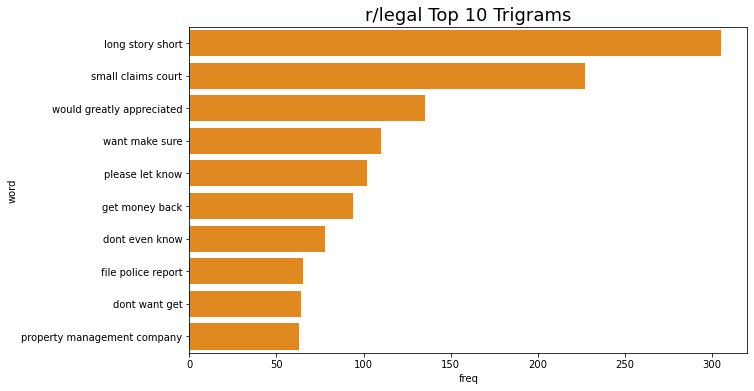

In [69]:
plot_top_words(legal,
               'combi_text', 
               10, 
               3, 
               'r/legal Top 10 Trigrams',
               'darkorange')

Here with `r/legaladvice` trigrams, I start to see instances where legal jargons like 'small claims court', 'get money back', 'file police report' and 'property management company' start appearing. This shows that structure, order and the context is important.

In [70]:
# Combine nostupid and legal with only 'subreddit' (target), 
# 'selftext', 'title', 'combi_text' and 'lem_combi_text' (features) columns
# different features will be tried out

df = pd.concat([nostupid[['subreddit', 'cleaned_selftext', 'cleaned_title', 'combi_text', 'lem_combi_text']],
                legal[['subreddit', 'cleaned_selftext', 'cleaned_title', 'combi_text', 'lem_combi_text']]], axis=0)

#Reset the index
df = df.reset_index(drop=True)

# Preview head of df to show nostupid
df.head(2)

,subreddit,cleaned_selftext,cleaned_title,combi_text,lem_combi_text
0,NoStupidQuestions,suppose we kidnap infant babies all of differ...,is different human behaviours occur because of...,is different human behaviours occur because of...,different human behaviour occur way raised bor...
1,NoStupidQuestions,they get richer after japan afik japan get ric...,how did korea get rich,how did korea get rich they get richer after j...,did korea rich richer japan afik japan rich su...


In [71]:
# Preview head of df to show legal
df.tail(2)

,subreddit,cleaned_selftext,cleaned_title,combi_text,lem_combi_text
23731,legaladvice,first some context i live in trinidad i move...,trespassing neighbor police wont help warning ...,trespassing neighbor police wont help warning ...,trespassing neighbor police wont help warning ...
23732,legaladvice,this story sounds like a dateline episode its ...,moms bf left her on floor unresponsive for da...,moms bf left her on floor unresponsive for da...,mom bf left floor unresponsive day getting me...


### Binarize target subreddit

In [72]:
# Replace `legaladvice` with 1, `NoStupidQuestions` with 0
df["subreddit"] = df["subreddit"].map(lambda x: 1 if x=="legaladvice" else 0 )

# Print shape of df
print(df.shape)

# Preview head of df to show 1s
df.head(2)

(23733, 5)


,subreddit,cleaned_selftext,cleaned_title,combi_text,lem_combi_text
0,0,suppose we kidnap infant babies all of differ...,is different human behaviours occur because of...,is different human behaviours occur because of...,different human behaviour occur way raised bor...
1,0,they get richer after japan afik japan get ric...,how did korea get rich,how did korea get rich they get richer after j...,did korea rich richer japan afik japan rich su...


In [73]:
df.tail(2)

,subreddit,cleaned_selftext,cleaned_title,combi_text,lem_combi_text
23731,1,first some context i live in trinidad i move...,trespassing neighbor police wont help warning ...,trespassing neighbor police wont help warning ...,trespassing neighbor police wont help warning ...
23732,1,this story sounds like a dateline episode its ...,moms bf left her on floor unresponsive for da...,moms bf left her on floor unresponsive for da...,mom bf left floor unresponsive day getting me...


In [74]:
combined = pd.concat([nostupid, legal], axis=0, ignore_index=True)

In [75]:
combined.head()

,author,is_self,is_video,num_comments,permalink,score,selftext,subreddit,title,upvote_ratio,created_utc,cleaned_title,cleaned_selftext,combi_text,lem_title,lem_selftext,lem_combi_text,length_combi_text,length_lem_combi_text,wcount_combi_text,wcount_lem_combi_text
0,throawaybitch,1,0,0,/r/NoStupidQuestions/comments/tidkny/is_differ...,1,Suppose we kidnap 100 infant babies all of dif...,NoStupidQuestions,Is different human behaviours occur because of...,1.0,1647752132,is different human behaviours occur because of...,suppose we kidnap infant babies all of differ...,is different human behaviours occur because of...,different human behaviour occur way raised bor...,suppose kidnap infant baby different culture ...,different human behaviour occur way raised bor...,658,377,115,52
1,AltairTheNightjar,1,0,0,/r/NoStupidQuestions/comments/tidhzu/how_did_k...,1,"They get richer after Japan, AFIK Japan get ri...",NoStupidQuestions,How did Korea get rich ?,1.0,1647751846,how did korea get rich,they get richer after japan afik japan get ric...,how did korea get rich they get richer after j...,did korea rich,richer japan afik japan rich support didnt pay...,did korea rich richer japan afik japan rich su...,222,123,43,20
2,Fadecation,1,0,0,/r/NoStupidQuestions/comments/tidhzs/if_i_went...,1,Just a random questions that popped into my mi...,NoStupidQuestions,If I went to the past and force my dad to ejac...,1.0,1647751846,if i went to the past and force my dad to ejac...,just a random questions that popped into my mi...,if i went to the past and force my dad to ejac...,went past force dad ejaculate having kid futur...,just random question popped mind let say pas...,went past force dad ejaculate having kid futur...,618,339,123,55
3,sadsackoffun1,1,0,0,/r/NoStupidQuestions/comments/tidgop/how_do_ri...,1,Is there like a giant hole somewhere it comes ...,NoStupidQuestions,How do rivers start?,1.0,1647751706,how do rivers start,is there like a giant hole somewhere it comes ...,how do rivers start is there like a giant hole...,river start,like giant hole come,river start like giant hole come,72,32,15,6
4,WeirdUniversity136,1,0,0,/r/NoStupidQuestions/comments/tidgc3/why_is_it...,1,I have worked plenty of service jobs and in my...,NoStupidQuestions,Why is it almost always old/middle aged people...,1.0,1647751669,why is it almost always oldmiddle aged people ...,i have worked plenty of service jobs and in my...,why is it almost always oldmiddle aged people ...,oldmiddle aged people bitch service worker,worked plenty service job experience old peopl...,oldmiddle aged people bitch service worker wor...,299,170,53,24


In [ ]:
df.to_csv('../datasets/cleaned.csv')